## Task 1

## Request all filings for the time interval

In [3]:
import json
import urllib.request
import pandas as pd

#lists to save all data
name = []
filed_at = []
form_type = []
form_desription = []
link = []
link2text = []

# API Key
TOKEN = 'f5bc2a835a2e0bbf61b377c77b88c6c2e526238fa710e4e192bb13d174a76242' # replace YOUR_API_KEY with the API key you got from sec-api.io after sign up
# API endpoint
API = "https://api.sec-api.io?token=" + TOKEN

expecting_rows_number = 6000

for number in range(0, expecting_rows_number, 200):
    try:
        # define the filter parameters you want to send to the API 
        #"query": "cik:320193 AND filedAt:{2021-01-01 TO 2021-03-31} AND formType:\"10-Q\""
        payload = {
          "query": { "query_string": { "query": "filedAt:{2021-01-01 TO 2021-03-31}"} },
          "from": str(number),
          "size": "200",
          "sort": [{ "filedAt": { "order": "desc" } }]
        }

        # format your payload to JSON bytes
        jsondata = json.dumps(payload)
        jsondataasbytes = jsondata.encode('utf-8')   # needs to be bytes

        # instantiate the request 
        req = urllib.request.Request(API)

        # set the correct HTTP header: Content-Type = application/json
        req.add_header('Content-Type', 'application/json; charset=utf-8')
        # set the correct length of your request
        req.add_header('Content-Length', len(jsondataasbytes))

        # send the request to the API
        response = urllib.request.urlopen(req, jsondataasbytes)

        # read the response 
        res_body = response.read()
        # transform the response into JSON
        filings = json.loads(res_body.decode("utf-8"))

        # print JSON 
        #print(filings)

        #itterate over all available documents and save them to lists
        for filing in filings['filings']:
            filed_at.append(filing['filedAt'])
            name.append(filing['companyName'])
            #sec.gov form types. 
            #see more info: https://sec-api.io/#list-of-sec-form-types
            form_type.append(filing['formType'])
            form_desription.append(filing['description'])
            #link to HTML, XML or PDF version of the filing.
            link.append(filing['linkToFilingDetails'])
            #link to the plain text version of the filing. This file can be multiple MBs large
            link2text.append(filing['linkToTxt'])
    except:
        pass

In [4]:
#save lists to pandas dataframe    
df = pd.DataFrame({'name': name,
                    'form_type': form_type,
                    'description' : form_desription,
                    'filed_at': filed_at,
                    'link': link,
                    'link2text': link2text})

In [5]:
pd.set_option('display.max_rows', None)
df

,name,form_type,description,filed_at,link,link2text
0,Morgan Stanley Finance LLC,FWP,Form FWP - Filing under Securities Act Rules 1...,2021-03-26T21:57:05-04:00,https://www.sec.gov/Archives/edgar/data/166626...,https://www.sec.gov/Archives/edgar/data/166626...
1,MORGAN STANLEY,FWP,Form FWP - Filing under Securities Act Rules 1...,2021-03-26T21:56:48-04:00,https://www.sec.gov/Archives/edgar/data/895421...,https://www.sec.gov/Archives/edgar/data/895421...
2,CME GROUP INC.,4,Form 4 - Statement of changes in beneficial ow...,2021-03-26T21:55:59-04:00,https://www.sec.gov/Archives/edgar/data/115637...,https://www.sec.gov/Archives/edgar/data/115637...
3,Tully Sean,4,Form 4 - Statement of changes in beneficial ow...,2021-03-26T21:55:59-04:00,https://www.sec.gov/Archives/edgar/data/115637...,https://www.sec.gov/Archives/edgar/data/161954...
4,Morgan Stanley Finance LLC,FWP,Form FWP - Filing under Securities Act Rules 1...,2021-03-26T21:55:10-04:00,https://www.sec.gov/Archives/edgar/data/166626...,https://www.sec.gov/Archives/edgar/data/166626...
5,MORGAN STANLEY,FWP,Form FWP - Filing under Securities Act Rules 1...,2021-03-26T21:54:46-04:00,https://www.sec.gov/Archives/edgar/data/895421...,https://www.sec.gov/Archives/edgar/data/895421...
6,Elite Education Group International Ltd,424B4,Form 424B4 - Prospectus [Rule 424(b)(4)],2021-03-26T21:54:41-04:00,https://www.sec.gov/Archives/edgar/data/178139...,https://www.sec.gov/Archives/edgar/data/178139...
7,MAGNA INTERNATIONAL INC,40-F,Form 40-F - Registration statement [Section 12...,2021-03-26T21:54:30-04:00,https://www.sec.gov/Archives/edgar/data/749098...,https://www.sec.gov/Archives/edgar/data/749098...
8,Wolff Allen,4,Form 4 - Statement of changes in beneficial ow...,2021-03-26T21:54:22-04:00,https://www.sec.gov/Archives/edgar/data/748592...,https://www.sec.gov/Archives/edgar/data/162852...
9,"Brooklyn ImmunoTherapeutics, Inc.",4,Form 4 - Statement of changes in beneficial ow...,2021-03-26T21:54:22-04:00,https://www.sec.gov/Archives/edgar/data/748592...,https://www.sec.gov/Archives/edgar/data/748592...


In [6]:
#save to excel
#df.to_excel('full_table.xlsx')

## Task 2

## The number of reporting forms in the 1st quartet of 2021

In [7]:
#df['form_type'].value_counts()

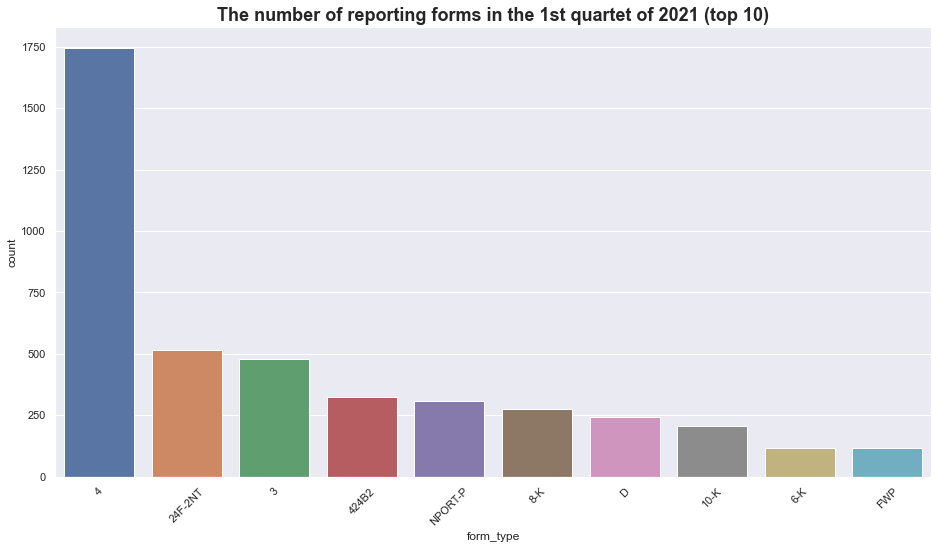

In [17]:
# forms' frequency
import seaborn as sns
import matplotlib as plt

#adjust the diagram size
sns.set(rc={'figure.figsize':(15.7,8.27)})
#plot a barplot
diagram = sns.countplot(x='form_type', data=df, order=df.form_type.value_counts().iloc[:10].index)
#rotate x labels 
for item in diagram.get_xticklabels():
    item.set_rotation(45)
#add title
diagram.set_title('The number of reporting forms in the 1st quartet of 2021 (top 10)', weight='bold').set_fontsize('18') 

#save the diagram
#diagram.figure.savefig('forms_number.png')

## The table shows which reporting forms were issued <br>  by what companies at what number for the 1st quarter

In [9]:
#show all columns and rows of the table
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

comparison = df[['name', 'form_type']].pivot_table(index='name', columns='form_type', 
                        aggfunc=len, fill_value=0)
#Total sum per row: 
comparison.loc[:,'Total'] = comparison.sum(axis=1)

#sort copanies by total entries
comparison = comparison.sort_values('Total' , ascending=False)

comparison

form_type,1-A,1-A POS,1-A/A,1-U,10-12B,10-12G/A,10-D,10-K,10-K/A,10-Q,11-K,13F-HR,13F-HR/A,15-12G,15-15D,15F-15D,19B-4E,20-F,20-F/A,24F-2NT,25-NSE,253G1,253G2,3,3/A,4,4/A,40-17F2,40-17G,40-17G/A,40-APP/A,40-F,40-F/A,424B1,424B2,424B3,424B4,424B5,424B7,424B8,425,485APOS,485BPOS,485BXT,486APOS,486BXT,487,497,497AD,497J,497K,5/A,6-K,6-K/A,8-A12B,8-K,8-K/A,8-K12B,ABS-15G,ABS-EE,ARS,ATS-N/UA,AW,C,C/A,CB,CERT,CFPORTAL/A,D,D/A,DEF 14A,DEF 14C,DEFA14A,DEFC14A,DEFM14A,DFAN14A,EFFECT,F-1,F-10,F-3,F-3ASR,F-4,F-6,F-X,FOCUSN,FWP,IRANNOTICE,MA-A,MA-I,MA-I/A,MA/A,N-14/A,N-2,N-2/A,N-23C-2,N-23C3A,N-CEN,N-CSR,N-CSRS,N-VPFS,NPORT-P,NPORT-P/A,NRSRO-CE,NT 10-K,POS AM,POS EX,PRE 14A,PRE 14C,PREC14A,PRER14A,PRRN14A,PX14A6G,QUALIF,REVOKED,S-1,S-1/A,S-1MEF,S-3,S-3/A,S-3ASR,S-4,S-4/A,S-6,S-8,S-8 POS,SC 13D,SC 13D/A,SC 13E3/A,SC 13G,SC 13G/A,SC 14D9,SC TO-C,SC TO-I,SC TO-I/A,SC TO-T/A,SC14D9C,SD,SUPPL,TA-1/A,TA-2,X-17A-5,X-17A-5/A,Total
name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Citigroup Global Markets Holdings Inc.,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,39,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,21,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,63
CITIGROUP INC,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,39,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,21,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,63
UBS AG,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,62,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,62
TRANSAMERICA FUNDS,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,59,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,60
JPMORGAN CHASE & CO,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,0,0,27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,40
MORGAN STANLEY,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,40
Morgan Stanley Finance LLC,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,40
HARBOR FUNDS,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,35,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,35
NATIONWIDE VARIABLE ACCOUNT II,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,29,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30


In [10]:
# just in case return display settings to the default mode 
pd.reset_option('^display.', silent=True)

In [11]:
#save to excel
#comparison.to_excel('comparison.xlsx')

## Top 10 reportings' forms by reporting date

In [12]:
#top 10 most popular forms
top_10 = df['form_type'].value_counts()[:10].keys().to_list()
top_10

['4', '24F-2NT', '3', '424B2', 'NPORT-P', '8-K', 'D', '10-K', '6-K', 'FWP']

In [13]:
#keep only dates and forms' types
reporting_date = df[['form_type', 'filed_at']]
#keep only the data about the top 10 most popular
reporting_date = reporting_date[reporting_date['form_type'].isin(top_10)]
#get rid of a time in the datetime value
reporting_date['filed_at'] = reporting_date['filed_at'].str.split('T').str[0]
reporting_date.head()

,form_type,filed_at
0,FWP,2021-03-26
1,FWP,2021-03-26
2,4,2021-03-26
3,4,2021-03-26
4,FWP,2021-03-26


## Filings frequency report by date

In [14]:
reporting_date.pivot_table(index='form_type', columns='filed_at', 
                        aggfunc=len, fill_value=0)

filed_at,2021-03-25,2021-03-26
form_type,,
10-K,22,186
24F-2NT,7,510
3,264,213
4,505,1238
424B2,71,254
6-K,12,106
8-K,43,231
D,49,192
FWP,27,90


# Task 3: Division

easy to recognise

* 3 - structure can be different depending on how many stockholders are in the company and types of stocks but in general .txt file has fixed layout and every row is reachable by tags
* 4 - structure can be different depending on how many stockholders are in the company and types of stocks but in general .txt file has fixed layout and every row is reachable by tags
* 4/A - structure can be different depending on how many stockholders are in the company and types of stocks but in general .txt file has fixed layout and every row is reachable by tags
* D - very simple
* 10-D - the same structure and tags in place
* 6-K - very simple

not that easy 

* FWP - structure is different and almost no tags in .txt form
* 424B2 - structure is different and almost no tags in .txt form
* 10-K - structure is different and .txt form representation is messy
* 8-K

more likely helps to estimate the fair price of a company

* 10-K - Anual report, probably one of the most important document here
* 4 - shows us is that whenever the CEO, CFO, or any other manager that owns more than 10% of the company’s stock buys or sells any of their shares. The reason this is a big deal is insiders have a real understanding of the internal goings-on inside the company,
* 4/A - an ammedment to 4
* D - quite detailed report about the company that would like to attract investments before/without the IPO
* 10-D - provides investors with info on asset-backed securities. Since these are signed documents submitted to the SEC, investors can have a high level of confidence in them. That is particularly important for asset-backed securities, where it is crucial to know if the physical assets actually exist.
* 8-K - there are a wide variety of events that can result in an 8-K being filed, including a company entering or leaving a significant contract, acquiring or getting rid of significant assets, entering receivership or bankruptcy and having a mine shut down for safety reasons. 

less likely helps to estimate the fair price of a company

* 3 - The information provided on the form is meant to disclose the holdings of directors, officers, and beneficial owners of registered companies. Not sure that the initial distribution of stocks provides us with valueable info. The turnover which is form number 4 is more intersting source of data
* FWP
* 424B2
* 6-K 